# Sections 
* [1. Set up](#1)
* [2. Data Load](#2)
* [3. Extracting Features & Optimising Dtypes to conserve memory](#3)
* [4. Understanding the Data, trends & Customer Behaviour](#4)
    * [4.1 Extracting Seasonality & Trends using Seasonal Decomposition](#4.1)
    * [4.2 Weekday and Weekend trends](#4.2)
    * [4.3 Refunds by Month](#4.3)
    * [4.4 Customer Purchase Behaviour (how regular are our customers?)](#4.4)
    * [4.5 Top 100 Customers Sales Snapshot](#4.5)
    * [4.6 Retention Curve](#4.6)
    	* [4.6.1 Cohort Analysis based on Start Month](#4.6.1)
	* [4.7 Number of Transacting Customers](#4.7)
* [5. Building a Spend Propensity Model](#5)
	* [5.1 Feature Engineering](#5.1)
	* [5.2 Final Dataframe with LRFM and purchase label](#5.2)
	* [5.3 Modeling & Evaluation on test set](#5.3)
        * [5.3.1 Logistic Regression](#5.3.1)
        * [5.3.2 Random Forest](#5.3.2)
        * [5.3.3 Evaluation of Randomforest](#5.3.3)
        * [5.3.4 Lift Curve](#5.3.4)
	* [5.4 Predicting 2 Months into the future](#5.4)
    * [5.5 Post Model Evaluation](#5.5)
        * [5.5.1 Lime for Local Interpretability](#5.5.1)
        * [5.5.2 Conclusion of our Churn propensity modeling](#5.5.2)
* [6. Customer Segmentation](#6)
	* [6.1 Creating 6 segments with percentile and score](#6.1)
	* [6.2 Deciding level and segments based on the sum of score](#6.2)
	* [6.3 Final dataframe with customers segmented and values of each level](#6.3) 
* [7. Cohort Analysys by Customer Segments and answering some business questions based on the data we have now](#7)
	* [7.1 Sales Numbers by Customer Segments](#7.1) 	
	* [7.2 Business Questions](#7.2)
	* [7.3 Refund Analysis by Customer Segments](#7.3)
	* [7.4 Channel behaviour by Customer Segments](#7.4)
    * [7.5 Scatter plot of all our customers based on RFM](#7.5)
* [8. Graph Analysis between branches & Customers](#8)
* [9. Scatter plot of revenue and count of unique products purchased by customer](#9)
* [10. Closing remarks](#10)

## 1. Importing all Libraries & Setup <a name=1></a>

In [1]:
import sys
sys.path.append('/Users/mukhtadirsyed/.pyenv/versions/3.11.1/lib/python3.11/site-packages')
import lifetimes
import numpy as np
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
import time
%matplotlib inline
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import matplotlib.pyplot as plt
from datetime import timedelta
import seaborn as sns
from pandas.api.types import CategoricalDtype
import plotly.express as px
from matplotlib.pyplot import figure
import plotnine as pn
import lime
from lime import lime_tabular




import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
sns.set(rc={'image.cmap': 'coolwarm'})

pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.3f}'.format

## 2. Loading the Dataset <a name=2></a>
- We converted the CSV file to parquet for faster load times and operational efficiency

In [2]:
%%time
df0=pd.read_parquet('/Users/mukhtadirsyed/transactions_dataset.parquet')

In [3]:
df0.info()

## 3. Extracting Features & Optimising Dtypes to conserve memory <a name=3></a>

In [4]:
#here we will optimise the dataset and also create some new features. Although these features will not be used for now

def extract_dates(df):
    df['data_order_year']=df['date_order'].dt.year
    df['data_order_month']=df['date_order'].dt.month_name()
    df['data_order_dayofmonth']=df['date_order'].dt.day
    df['data_order_dayofweek']=df['date_order'].dt.day_name()
    df['month_year'] = df['date_order'].dt.strftime('%Y-%m')
    return df

def data_optimize(df):
    df.product_id= df.product_id.astype(np.int32)
    df.client_id= df.client_id.astype(np.int32)
    df.quantity= df.quantity.astype(np.int32)
    df.branch_id= df.branch_id.astype(np.int16)
    df.sales_net=df.sales_net.astype(np.float32)
    df['date_order'] =  pd.to_datetime(df['date_order'], format='%Y-%m-%d')
    df['date_invoice'] =  pd.to_datetime(df['date_invoice'], format='%Y-%m-%d')
    df.order_channel= df.order_channel.astype('category')
    return df

df=(df0
.pipe(data_optimize)
.pipe(extract_dates))

df[['data_order_month', 'data_order_year', 'data_order_dayofweek', 'data_order_dayofmonth','month_year']]=df[['data_order_month', 'data_order_year', 'data_order_dayofweek', 'data_order_dayofmonth','month_year']].astype('category')


In [5]:
# df=pd.read_parquet('df.parquet') this is a file created after above optimisations, can be ignored

In [6]:
#checking for memory usage after the above optimisation

print(f'The dataframe is now using {df.memory_usage(deep=True).sum()/1e+9} GB memory')

The dataframe is now using 2.532776154 GB memory


In [7]:
df.head()

,date_order,date_invoice,product_id,client_id,sales_net,quantity,order_channel,branch_id,data_order_year,data_order_month,data_order_dayofmonth,data_order_dayofweek,month_year
0,2017-09-25,2017-09-25,2376333,188502,155.443,3,online,2732,2017,September,25,Monday,2017-09
1,2017-09-25,2017-09-25,2520527,835089,16.394,3,at the store,10279,2017,September,25,Monday,2017-09
2,2017-09-25,2017-09-25,2536756,1977896,365.766,21,online,6184,2017,September,25,Monday,2017-09
3,2017-09-25,2017-09-25,3028673,598816,8.599,201,at the store,4200,2017,September,25,Monday,2017-09
4,2017-09-25,2017-09-25,203377,2086861,"1,093.374",3,by phone,7051,2017,September,25,Monday,2017-09


In [8]:
#there are negtaive transactions in the dataset, we will not consider them now. Creating a new dataset with only positive values
df_trans=df.query('sales_net > 0')


In [9]:
df_trans.sales_net.describe() # we have lost about 6 million rows if we consider only positive transactions

count   58,514,567.000
mean           141.635
std            812.948
min              0.018
25%             19.364
50%             51.799
75%            143.879
max      1,740,456.000
Name: sales_net, dtype: float64

## 4. Understanding the Data, trends & Customer Behaviour <a name=4></a>

### 4.1 Extracting Seasonality & Trends using Seasonal Decomposition <a name=4.1></a>

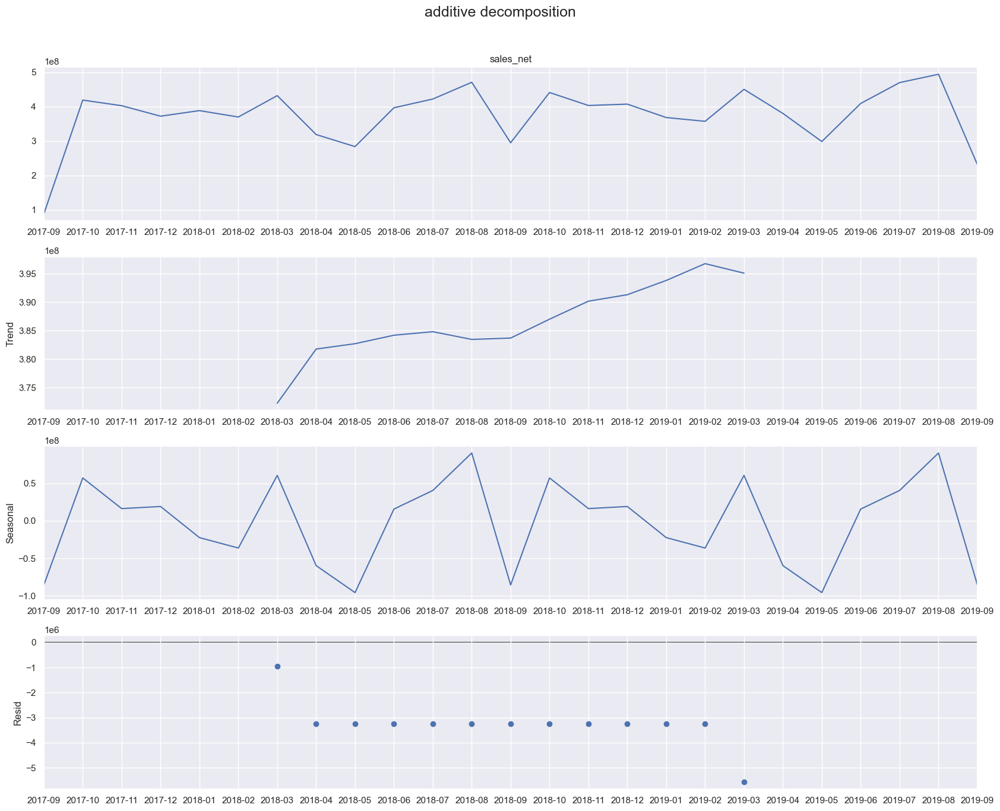

In [10]:
from statsmodels.tsa.seasonal import seasonal_decompose

def getDecompositionPlot(data,freq,title):
    results = seasonal_decompose(
        x=data, 
        period=freq,
        model="additive"
        )

    plt.rc("figure", figsize=(17,13))
    results.plot().suptitle(title, y=1.05, fontsize = 18)
    plt.show()

getDecompositionPlot(df.groupby('month_year')['sales_net'].sum(),12,"additive decomposition")



### What do we observe here?
- There is some seasonality wherein the sales go down in April/May and then pick up in the seocnd half of May, the drop again repeats in the second half of September
- There seems to be some growth trend from the start of 2018 to start of 2019
- We only have 2 years of data, the above 2 points can only be validated if more data is provided. However, these are the observed trends and seasonality in the 2 year window

### 4.2 Weekday and Weekend trends <a name=4.2></a>

In [11]:
week_sales=df.groupby(['date_order','data_order_dayofweek'])['sales_net'].sum().to_frame().query('sales_net>0').reset_index()

cats = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
cat_type = CategoricalDtype(categories=cats, ordered=True)
week_sales['data_order_dayofweek'] = week_sales['data_order_dayofweek'].astype(cat_type)
week_sales=week_sales.sort_values('data_order_dayofweek')

fig = px.box(week_sales, x="data_order_dayofweek", y="sales_net",
             color="data_order_dayofweek",
             title="Sales by Day of Week",
             labels={"sales_net": "Revenue", "data_order_dayofweek": "Day of Week"})

fig.show()

### What do we observe here?
- Sales are Negligible during the weekends with Tue- Thursday being the best days

### 4.3 Refunds by Month <a name=4.3></a>
- Assuming negative transactions are refunds

In [12]:
refunds_by_month=(df_trans.groupby('month_year')['sales_net'].sum().to_frame()
 .merge(df.groupby('month_year')['sales_net'].sum().to_frame(), left_index=True, right_index=True, how='inner')
 .assign(Refunds=lambda x: x['sales_net_x'] - x['sales_net_y'])
 .assign(Percentage_Refunds=lambda x: x['Refunds'] / x['sales_net_x']*100)
 .rename(columns={'sales_net_x':'Total_Sales','sales_net_y':'Net_Sales'}))

fig = px.line(refunds_by_month.reset_index(), x='month_year', y=['Total_Sales', 'Net_Sales', 'Refunds'], 
              color='variable',
              title="Refunds by Month (mostly constant at around 5-6% of Total Sales)")
fig.update_layout(yaxis_title="Sales")
fig.show()

### 4.4 Overall Customer Purchase Behaviour <a name=4.4></a>
- Checking for irregular purchase behaviour

In [13]:
df_clients= df[['client_id', 'month_year','sales_net']]
df_clients=df_clients.pivot_table(index='client_id',columns='month_year', aggfunc='sum')
#dropping the first column and last since these months do not have full month data
df_clients.drop([('sales_net', '2017-09'), ('sales_net', '2019-09')],axis=1, inplace=True) # multi index
# we have 23 months and we need to decide who are our regular buyers
df_clients['months_with_trans']=(df_clients != 0).sum(axis=1)
fig = px.histogram(df_clients, x="months_with_trans",
                  labels={'months_with_trans':'Number of Months with atleast one transaction'},
                  title='Count of Customers')
fig.update_layout(bargap=0.05)
fig.show()

### What do we observe here?
- High number of irregular purchase
- There are 3377 customers who haven't done any transaction in any of the months (or have refunded)
- 25k customers only in one month
- on the other hand, there are about 20k customers who have transacted everymonth
- Of the total customers(170k) appoximately 100k have only transacted in 10 months or less

### 4.5 Top 100 Customers Sales Snapshot <a name=4.5></a>

In [14]:
#percentage of revenue generated by top100
top100=df.groupby('client_id')['sales_net'].sum().to_frame().sort_values('sales_net', ascending=False).head(100).reset_index()['client_id'].to_list()
print(f"Percentage of revenue generated by top 100: {df.query('client_id in @top100')['sales_net'].sum()/df['sales_net'].sum()*100:.2f}%")

Percentage of revenue generated by top 100: 6.36%


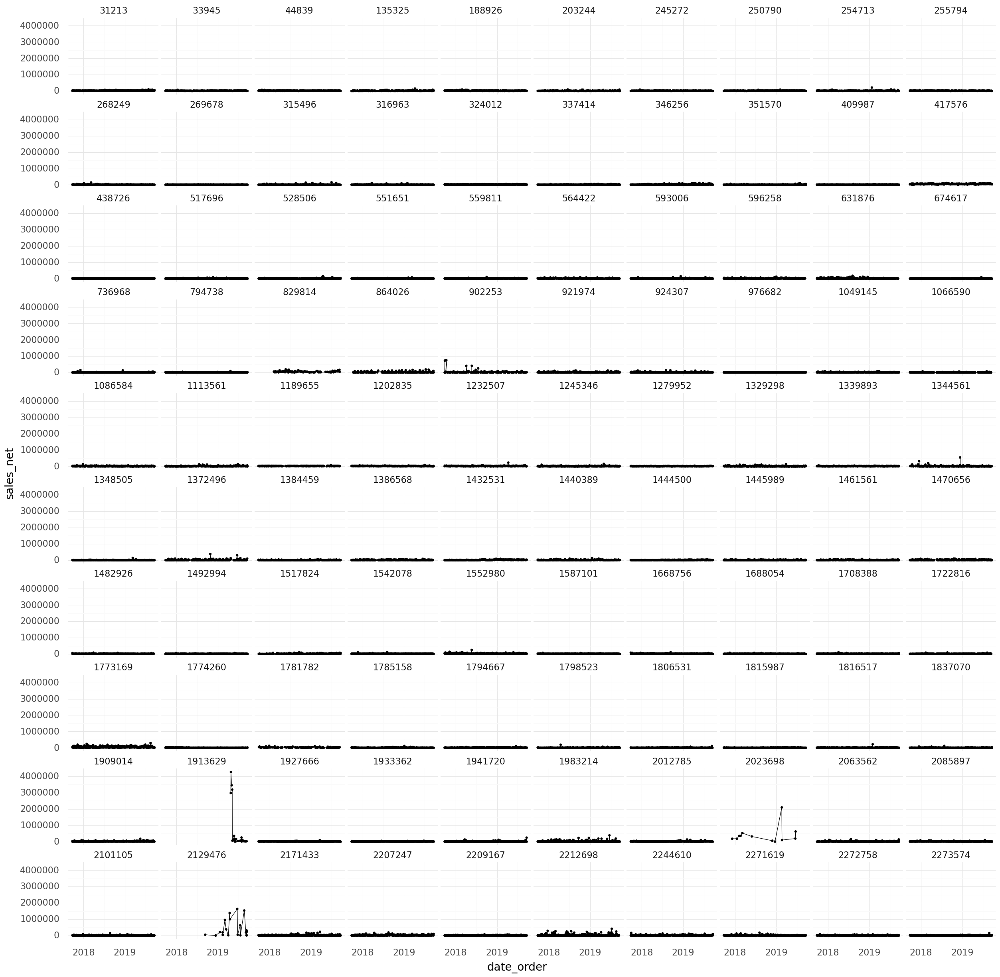

In [15]:
top100=df.groupby('client_id')['sales_net'].sum().to_frame().sort_values('sales_net', ascending=False).head(100).reset_index()['client_id'].to_list()
top100sales=df.query('client_id in @top100').groupby(['client_id','date_order']).agg({'sales_net':'sum'}).reset_index()
pn.theme_set(pn.theme_minimal(base_size=20))
p=(pn.ggplot(mapping=
    pn.aes('date_order','sales_net', group ='client_id'),
    data=top100sales)
+pn.geom_line()\
+pn.geom_point()\
+pn.facet_wrap('client_id')\
+pn.scale_x_date(
date_breaks ="1 year",
date_labels="%Y")
+pn.theme(figure_size=(30, 30))
).draw(); 

In [16]:
#saving the above plot

p=(pn.ggplot(mapping=
pn.aes('date_order','sales_net', group ='client_id'),
data=top100sales)
+pn.geom_line()\
+pn.geom_point()\
+pn.facet_wrap('client_id')\
+pn.scale_x_date(
date_breaks ="1 year",
date_labels="%Y")
+pn.theme(figure_size=(30, 30), panel_background=pn.element_rect(fill="white"), plot_background=pn.element_rect(fill="white"))
).save('plot.png',limitsize=False, dpi=800)

### What do we observe here?
- Most of the top customers are doing steady business
- There are some anomolies here which can be looked into, for eg. customer 2129476 & 1913629 seems to have joined pretty late into our observable 2 year period but has made it to the top 100 list

### 4.6 Retention Curve <a name=4.6></a>

#### Start day and days since start

In [17]:
df_retention=df.groupby(['client_id','date_order'])['sales_net'].sum().reset_index()
start_date = df_retention.groupby('client_id')['date_order'].min()
start_date = start_date.rename("start_day")
df_retention = pd.merge(df_retention, start_date, left_on='client_id', right_index=True)
df_retention.head()

,client_id,date_order,sales_net,start_day
0,6,2017-10-27,"1,358.090",2017-10-27
1,6,2017-11-29,204.130,2017-10-27
2,6,2018-03-30,462.552,2017-10-27
3,6,2018-05-10,572.473,2017-10-27
4,6,2018-11-20,270.802,2017-10-27


In [18]:
df_retention[['date_order','start_day']]=df_retention[['date_order','start_day']].apply(pd.to_datetime)
df_retention['days_since_start'] = (df_retention['date_order'] - df_retention['start_day']).dt.days
df_retention.head()

,client_id,date_order,sales_net,start_day,days_since_start
0,6,2017-10-27,"1,358.090",2017-10-27,0
1,6,2017-11-29,204.130,2017-10-27,33
2,6,2018-03-30,462.552,2017-10-27,154
3,6,2018-05-10,572.473,2017-10-27,195
4,6,2018-11-20,270.802,2017-10-27,389


#### Start Week and Weeks Since Start

In [19]:
# Extract start week
df_retention['start_week'] = df_retention.apply(lambda x: (x['start_day'] - pd.Timedelta(x['start_day'].dayofweek, u='day')).date(), axis=1)

df_retention['start_week'] = pd.to_datetime(df_retention['start_week'])

# Get the number of weeks since the user started
df_retention['weeks_since_start'] = np.floor((df_retention['date_order'] - df_retention['start_week']) / np.timedelta64(1, 'W'))

#### Start Month and months since start

In [20]:
df_retention['start_month'] = df_retention['start_day'].values.astype('datetime64[M]')

# Get the number of months since the user started
df_retention['months_since_start'] = np.floor((df_retention['date_order'] - df_retention['start_month']) / np.timedelta64(1, 'M'))

df_retention[['days_since_start','weeks_since_start','months_since_start']]=df_retention[['days_since_start','weeks_since_start','months_since_start']].astype('int16')
df_retention['start_month']=  df_retention['start_month'].dt.strftime('%Y-%m') 
df_retention.head(1000)

,client_id,date_order,sales_net,start_day,days_since_start,start_week,weeks_since_start,start_month,months_since_start
0,6,2017-10-27,"1,358.090",2017-10-27,0,2017-10-26,0,2017-10,0
1,6,2017-11-29,204.130,2017-10-27,33,2017-10-26,4,2017-10,1
2,6,2018-03-30,462.552,2017-10-27,154,2017-10-26,22,2017-10,5
3,6,2018-05-10,572.473,2017-10-27,195,2017-10-26,28,2017-10,7
4,6,2018-11-20,270.802,2017-10-27,389,2017-10-26,55,2017-10,13
...,...,...,...,...,...,...,...,...,...
995,118,2018-06-19,248.984,2017-10-18,244,2017-10-17,35,2017-10,8
996,118,2018-07-03,332.156,2017-10-18,258,2017-10-17,37,2017-10,9
997,118,2018-07-10,447.695,2017-10-18,265,2017-10-17,38,2017-10,9
998,118,2018-07-11,925.973,2017-10-18,266,2017-10-17,38,2017-10,9


#### 4.6.1 Cohort Analysis based on Start Month <a name=4.6.1></a>

In [21]:
# pd.options.display.float_format = '{:,.0f}'.format
cohorts = df_retention.groupby(['start_month','months_since_start']).nunique()
cohorts = cohorts.client_id.to_frame().reset_index()   # convert series to frame
cohorts = pd.pivot_table(cohorts, values = 'client_id',index = 'start_month', columns= 'months_since_start')
cohorts.replace(np.nan, '',regex=True)

months_since_start,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
start_month,,,,,,,,,,,,,,,,,,,,,,,,,
2017-09,"39,862.000","35,043.000","34,070.000","32,807.000","32,632.000","32,327.000","32,134.000","30,315.000","29,773.000","31,608.000","31,645.000","31,697.000","30,017.000","31,178.000","30,078.000","29,838.000","29,083.000","28,818.000","29,398.000","27,778.000","26,956.000","29,166.000","28,987.000","28,916.000","25,660.000"
2017-10,"41,443.000","25,500.000","23,584.000","22,844.000","23,664.000","22,393.000","20,241.000","19,419.000","22,014.000","23,132.000","23,242.000","19,733.000","22,279.000","21,355.000","20,638.000","19,187.000","19,528.000","20,048.000","18,269.000","16,611.000","20,415.000","20,006.000","20,659.000","15,166.000",
2017-11,"15,197.000","6,077.000","5,862.000","5,749.000","5,663.000","4,760.000","4,589.000","5,658.000","5,633.000","5,822.000","4,734.000","5,665.000","5,202.000","5,134.000","4,576.000","4,594.000","5,060.000","4,292.000","3,877.000","5,052.000","5,099.000","5,148.000","3,551.000",,
2017-12,"9,081.000","3,262.000","3,156.000","2,866.000","2,585.000","2,297.000","2,841.000","2,863.000","2,963.000","2,416.000","2,777.000","2,643.000","2,689.000","2,454.000","2,424.000","2,489.000","2,246.000","1,961.000","2,593.000","2,464.000","2,622.000","1,706.000",,,
2018-01,"7,058.000","2,453.000","2,238.000","1,794.000","1,641.000","2,074.000","2,158.000","2,091.000","1,754.000","2,037.000","1,870.000","1,946.000","1,667.000","1,748.000","1,824.000","1,543.000","1,465.000","1,865.000","1,912.000","1,848.000","1,268.000",,,,
2018-02,"5,244.000","1,676.000","1,326.000","1,201.000","1,536.000","1,514.000","1,490.000","1,263.000","1,403.000","1,271.000","1,328.000","1,206.000","1,126.000","1,308.000","1,034.000",965.000,"1,307.000","1,254.000","1,366.000",820.000,,,,,
2018-03,"5,128.000","1,445.000","1,239.000","1,393.000","1,429.000","1,490.000","1,234.000","1,325.000","1,264.000","1,193.000","1,132.000","1,211.000","1,207.000","1,144.000","1,018.000","1,171.000","1,230.000","1,303.000",869.000,,,,,,
2018-04,"3,313.000",944.000,957.000,943.000,968.000,730.000,863.000,806.000,731.000,722.000,731.000,760.000,721.000,637.000,739.000,749.000,780.000,550.000,,,,,,,
2018-05,"2,887.000",879.000,762.000,826.000,601.000,703.000,680.000,618.000,534.000,580.000,591.000,538.000,549.000,614.000,607.000,683.000,438.000,,,,,,,,


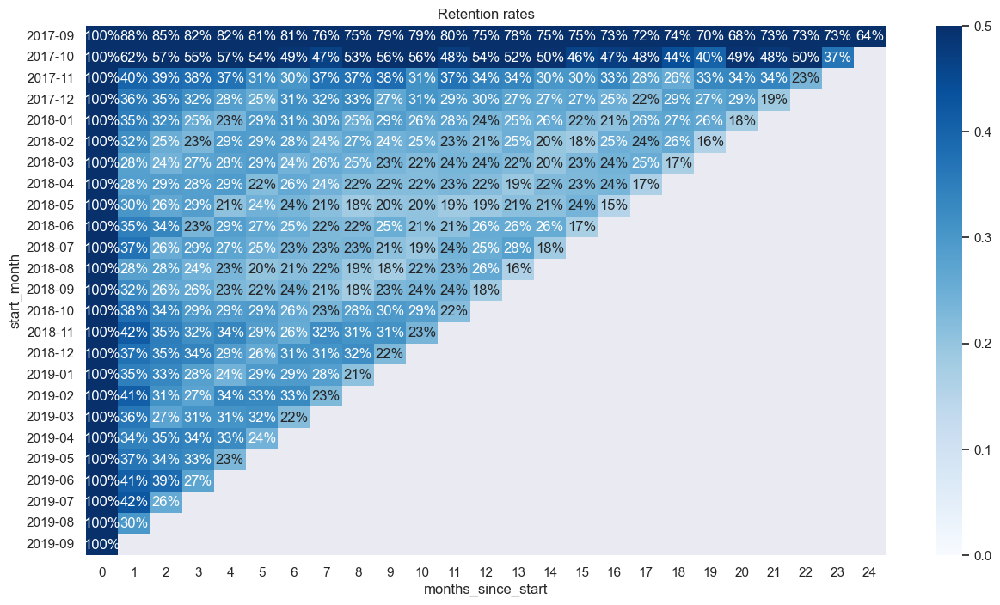

In [22]:
cohort_sizes = cohorts.iloc[:,0]
retention = cohorts.divide(cohort_sizes, axis=0)
retention.round(3) * 100
plt.figure(figsize=(15, 8))
plt.title('Retention rates')
sns.heatmap(data = retention, annot = True, fmt = '.0%',vmin = 0.0,vmax = 0.5,cmap = 'Blues')
plt.show()

In [23]:
cohorts_t = cohorts.transpose()

fig = px.line(cohorts_t, title="Cohort Analysis", height=600)
fig.update_layout(yaxis=dict(title='% of Active'))
fig.show()

### What do we observe here?
- The above plots divide the customers into cohorts based on when they first transacted. SO there are about 39k customers who transacted in Sep 2017 and in that cohort how many customers have stayed active through the next 24 months
- We see a steep drop after teh customers make their first transactions. This points to the same fact that majority of the customers do not do tranactions every month
- The retention curve for a slice of 2 year data is not very informative, we will look at total transacting customers on a monthly basis and what does that look like


### 4.7 Number of transacting customers <a name=4.7></a>

In [24]:
data=df_trans.groupby('month_year')['client_id'].nunique().to_frame() #number of trasacting customers (without refunds)
data=data.assign(Percentage_of_Total=lambda x: x['client_id']/170589*100)
fig = px.line(data.reset_index(), x='month_year', y='client_id',title="Transaction Trend", height=400)
fig.update_layout(yaxis=dict(title='Number of Transacting Customers'))
# Add a secondary y-axis for the percentage data
fig.update_layout(yaxis2=dict(title='Percentage_of_Total',
                               overlaying='y',
                               side='right',
                               showgrid=False,
                               range=[0, 100]))

# Add a line for the percentage data
fig.add_trace(dict(x=data.reset_index()['month_year'], y=data['Percentage_of_Total'], 
                   mode='lines', line=dict(width=2, color='firebrick'), yaxis='y2',
                   showlegend=False))

# fig.write_html("cohort-transacting-customers-analysis.html")
fig.show()


### What do we observe here?
- There are a total of 170589 unique customers in our dataset 
- This plot shows how many of them have transacted on a monthly basis
- Leaving out the first and last months since we do not have full month data, we see that this number varies between 64k - 80k which is approximately 40%
- Keep in mind that we do not know the actual start date and end date of each customer, there is a possibility that of the 170589 customers mentioned in the dataset, a few of them could have joined during the 2 year period (or churned). Hence total customers can vary across the months

## 5. Spend Propensity Model <a name=5></a>
- From the above we know that a lot of the customers do not purchase regularly
- In this section we will be building a machine learning model that will predict whether a customer will spend or not in the next 60 days
- Hence instead of giving a flag of Churn (1) or Not Churn(1). We prefer to use the flag Will spend(1) and Will not Spend(0). This would be a more accurate representation of the behaviour

### 5.1 Feature Engineering for our Model <a name=5.1></a>
- L (Length) the difference in days between the first invoice and the last invoice. The length of the customer in the observed dataset as measured in days
- R (Recency) the difference in days between the last invoice of the customer and last invoice date of the observed dataset
- F (Frequency) how many times have the customers purchased
- M (Monterary) 2 values here the total sum of transactions and average per transaction

In [25]:
#for LRFM we only need these features
df_exp=df_trans[['client_id','date_order','sales_net']].sort_values('date_order')

In [26]:
#just checking the dimensions of our new data frame
df_exp.shape

(58514567, 3)

#### Creation of training and validation set 

In [27]:
#checking for maximum data in our data frame
max_date= df_exp.date_order.max()
max_date

Timestamp('2019-09-22 00:00:00')

In [28]:
# this step is needed to create the training and validation set. The last 60 days is the validation set

n_days=60
cutoff=max_date - pd.to_timedelta(n_days, unit="d")
temporal_in_df = df[df['date_order'] <=cutoff] #training set till 24th July
temporal_out_df = df_exp[df_exp['date_order'] > cutoff] #validation set from 25th July to end of dataset

In [29]:
temporal_out_df.date_order.max(), temporal_in_df.date_order.max()

(Timestamp('2019-09-22 00:00:00'), Timestamp('2019-07-24 00:00:00'))

In [30]:
temporal_out_df.shape, temporal_in_df.shape

((4997354, 3), (57922853, 13))

#### Creating the targets dataframe with labels

In [31]:
d = {'client_id': temporal_out_df.client_id.unique(), 'spend_60_flag': 1}

targets_df=pd.DataFrame(data=d)

In [32]:
targets_df.set_index('client_id', inplace=True)

In [33]:
targets_df.head() # this is essentially the list of customers who have spent in the last 60 days, we will be using this later

,spend_60_flag
client_id,
776358,1
1990277,1
1067614,1
669351,1
1571044,1


### Recency

In [34]:
#last date of the training set
max_date_in=temporal_in_df['date_order'].max()
max_date_in

Timestamp('2019-07-24 00:00:00')

In [35]:
#note we have taken here only positive transactions
recency_features_df=temporal_in_df.query('sales_net>0')\
[['client_id', 'date_order']].groupby('client_id')\
.apply(lambda x: (x['date_order'].max() - max_date_in) / pd.to_timedelta(1,"day"))\
.to_frame().set_axis(["recency"],axis=1)


In [36]:
recency_features_df.head()

,recency
client_id,
6,-161.000
7,-212.000
14,-1.000
18,-1.000
25,-287.000


### Frequency
- count the number of days a customer has made a transaction

In [37]:
frequency_features_days_df = temporal_in_df.query('sales_net>0')\
[['client_id','date_order']]\
.groupby('client_id')['date_order']\
.nunique()\
.to_frame()\
.set_axis(['frequency'],axis=1)

frequency_features_days_df.head()


,frequency
client_id,
6,10
7,2
14,464
18,266
25,1


### Monetary
- taking both total sum and average per transaction

In [38]:
monetary_features_df = temporal_in_df.groupby('client_id').aggregate({'sales_net':['sum','mean']})\
.set_axis(['sales_sum','sales_mean'],axis=1)
monetary_features_df.head()

,sales_sum,sales_mean
client_id,,
6,"3,492.387",124.728
7,"1,190.777",79.385
14,"2,866,956.000",246.939
18,"191,074.375",93.756
25,374.586,93.647


In [39]:
#monetary feature
price_features_df = temporal_in_df.groupby('client_id').aggregate({'sales_net':['sum','mean']})\
.set_axis(['sales_sum','sales_mean'],axis=1)
price_features_df.head()

,sales_sum,sales_mean
client_id,,
6,"3,492.387",124.728
7,"1,190.777",79.385
14,"2,866,956.000",246.939
18,"191,074.375",93.756
25,374.586,93.647


### Length
- diff in days between the first invoice and last

In [40]:
length_features_df= temporal_in_df.query('sales_net>0')\
[['client_id', 'date_order']]\
.groupby('client_id')\
.apply(lambda x: (x['date_order'].max() - x['date_order'].min()) / pd.to_timedelta(1,"day"))\
.to_frame().set_axis(["length"],axis=1)

In [41]:
length_features_df.head()

,length
client_id,
6,474.000
7,161.000
14,666.000
18,665.000
25,0.000


### 5.2 Final Dataframe with LRFM and purchase label <a name=5.2></a>

In [42]:
#combining data frames
features_df= pd.concat([recency_features_df,frequency_features_days_df,monetary_features_df, length_features_df], axis=1)\
.merge(targets_df,
      left_index=True,
      right_index=True,
      how='left').fillna(0) # filling 0 for customers who havent done any transaction in the last 60 days

In [43]:
features_df.head()


,recency,frequency,sales_sum,sales_mean,length,spend_60_flag
client_id,,,,,,
6,-161.000,10.000,"3,492.387",124.728,474.000,1.000
7,-212.000,2.000,"1,190.777",79.385,161.000,0.000
14,-1.000,464.000,"2,866,956.000",246.939,666.000,1.000
18,-1.000,266.000,"191,074.375",93.756,665.000,1.000
25,-287.000,1.000,374.586,93.647,0.000,0.000


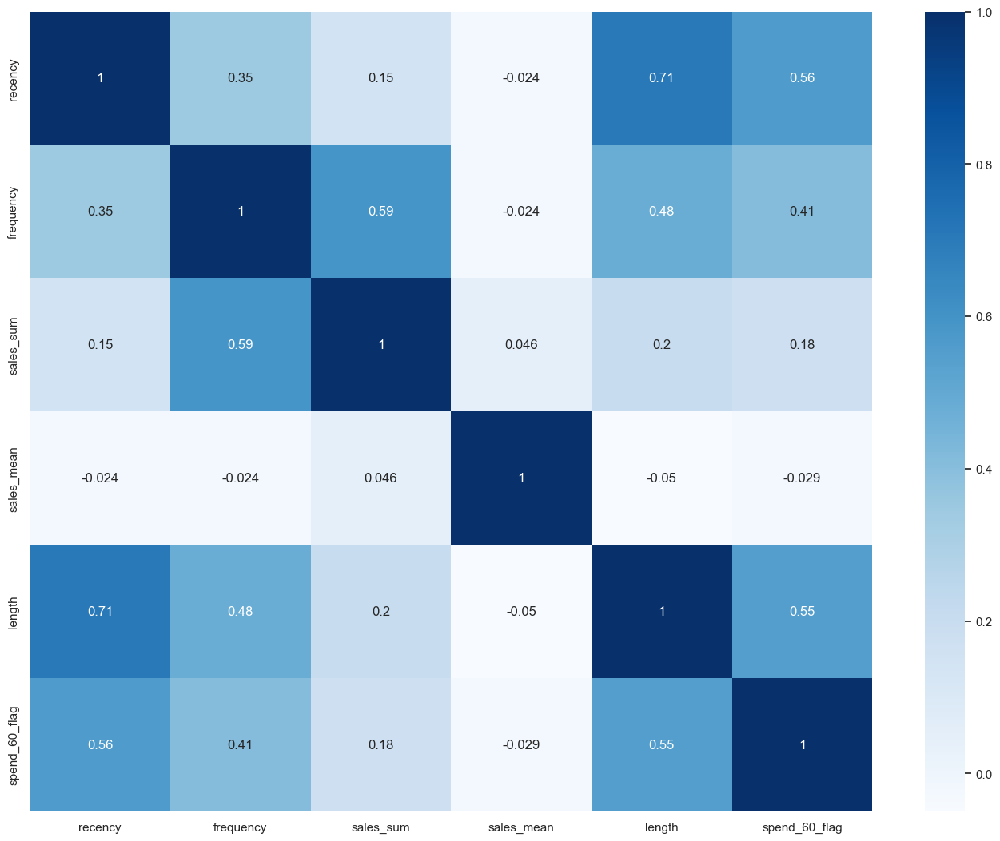

In [44]:
sns.heatmap(features_df.corr(), annot=True, cmap = 'Blues')
sns.set(rc={'figure.figsize':(8,8)})
plt.show()

In [45]:
features_df.spend_60_flag.value_counts() # almost a balanced dataset

1.000    87752
0.000    78575
Name: spend_60_flag, dtype: int64

## 5.3 Modeling & Evaluation <a name=5.3></a>
- Testing first on the validation set which we will create
- After evaluating scores, we will train on the entire data set and predict 2 months into the future

In [46]:
#we can now start with modeling
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from scipy.stats import loguniform
from scipy.stats import uniform
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report
import pickle

In [47]:
from sklearn.model_selection import train_test_split
X = features_df[['recency', 'frequency', 'sales_sum', 'sales_mean','length']]
y = features_df['spend_60_flag']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 5)

### 5.3.1 Logistic Regession <a name=5.3.1></a>

In [48]:
# define the parameter space for hyperparameter tuning
param_dist = {'logisticregression__C': uniform(loc=0, scale=4),
              'logisticregression__solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
              'logisticregression__penalty': ['l1', 'l2', 'elasticnet', 'none']}

# create a pipeline with StandardScaler and LogisticRegression
pipe = Pipeline([('scaler', StandardScaler()), ('logisticregression', LogisticRegression())])

# create a randomized search cross-validation object with 5-fold cross-validation
random_search = RandomizedSearchCV(pipe, param_distributions=param_dist, n_iter=20, cv=5,verbose=0)

# fit the randomized search cross-validation object to the training data
random_search.fit(X_train, y_train)

# make predictions on the training data
y_pred_lr = random_search.predict(X_test)
predictions_clf_prob_lr=random_search.predict_proba(X_test)[:,1] # probabilities
# calculate the accuracy score on the training data
accuracy_lr = accuracy_score(y_test, y_pred_lr)
roc_score_lr=roc_auc_score(y_test, predictions_clf_prob_lr)
report = classification_report(y_test, y_pred_lr, output_dict=True)


# print the best parameters and the accuracy score
print("Best parameters found: ", random_search.best_params_)
print("Accuracy for LR: ", accuracy_lr)
print("RoC: ", roc_score_lr)


Best parameters found:  {'logisticregression__C': 1.841006241275907, 'logisticregression__penalty': 'none', 'logisticregression__solver': 'sag'}
Accuracy for LR:  0.8021403234533758
RoC:  0.8868863418031913


In [49]:
pd.DataFrame(report)

,0.0,1.0,accuracy,macro avg,weighted avg
precision,0.821,0.788,0.802,0.804,0.804
recall,0.748,0.852,0.802,0.800,0.802
f1-score,0.782,0.819,0.802,0.801,0.801
support,"15,831.000","17,435.000",0.802,"33,266.000","33,266.000"


### 5.3.2 Random Forest <a name=5.3.2></a>

In [50]:
# define the parameter space for hyperparameter tuning of random forest classifier
random_forest_param_dist = {'randomforestclassifier__n_estimators': [1800,2500,3000,5000],
                            'randomforestclassifier__criterion': ['gini', 'entropy'],
                            'randomforestclassifier__max_depth': [None,10, 20, 30, 50]}

# create a pipeline with StandardScaler and RandomForestClassifier
random_forest_pipe = Pipeline([('scaler', StandardScaler()), ('randomforestclassifier', RandomForestClassifier())])
# create a randomized search cross-validation object with 5-fold cross-validation for random forest classifier
random_forest_random_search = RandomizedSearchCV(random_forest_pipe, param_distributions=random_forest_param_dist, n_iter=5, cv=5,verbose=2)
# fit the randomized search cross-validation object to the training data for random forest classifier
random_forest_random_search.fit(X_train, y_train)
# make predictions on the training data
y_pred_rf = random_forest_random_search.predict(X_test)
#Probabilities
predictions_clf_prob_rf=random_forest_random_search.predict_proba(X_test)[:,1] # probabilities

#### Saving and using the model for future use

In [51]:
run this cell only if you have saved the model for randomforest
filename = 'finalized_model.pkl'
pickle.dump(random_forest_random_search, open(filename, 'wb'))
random_forest_random_search = pickle.load(open('finalized_model.pkl', 'rb'))
y_pred_rf=random_forest_random_search.predict(X_test)
predictions_clf_prob_rf=random_forest_random_search.predict_proba(X_test)[:,1] # probabilities

In [52]:
# calculate the accuracy score & other metrics on the training data
accuracy_rf = accuracy_score(y_test, y_pred_rf)
roc_score_rf=roc_auc_score(y_test, predictions_clf_prob_rf)
report_rf = classification_report(y_test, y_pred_rf, output_dict=True)


# print the best parameters and the accuracy score
print("Best parameters found: ", random_forest_random_search.best_params_)
print("Accuracy for Random Forest: ", accuracy_rf)
print("RoC: ", roc_score_rf)

Best parameters found:  {'randomforestclassifier__n_estimators': 2500, 'randomforestclassifier__max_depth': 20, 'randomforestclassifier__criterion': 'entropy'}
Accuracy for Random Forest:  0.8198160283773221
RoC:  0.9005987298048137


In [53]:
pd.DataFrame(report_rf)

,0.0,1.0,accuracy,macro avg,weighted avg
precision,0.793,0.847,0.820,0.820,0.821
recall,0.841,0.800,0.820,0.821,0.820
f1-score,0.816,0.823,0.820,0.820,0.820
support,"15,831.000","17,435.000",0.820,"33,266.000","33,266.000"


### 5.3.3 Evaluation of Ramdomforest <a name=5.3.3></a>

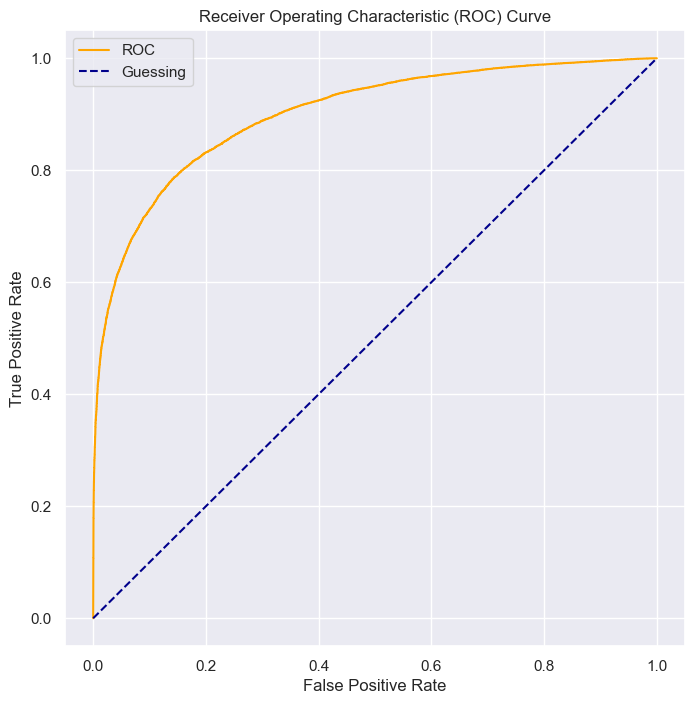

<Figure size 640x640 with 0 Axes>

In [54]:
from sklearn.metrics import roc_curve
def plot_roc_curve(fpr, tpr):
    """
    Plots a ROC curve given the false positve rate (fpr) and 
    true postive rate (tpr) of a classifier.
    """
    # Plot ROC curve
    plt.plot(fpr, tpr, color='orange', label='ROC')
    # Plot line with no predictive power (baseline)
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--', label='Guessing')
    # Customize the plot
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.figure(figsize=(8, 8), dpi=80)
    plt.show()
fpr, tpr, thresholds = roc_curve(y_test, predictions_clf_prob_rf)

plot_roc_curve(fpr, tpr);

In [55]:
len(y_pred_rf)

33266

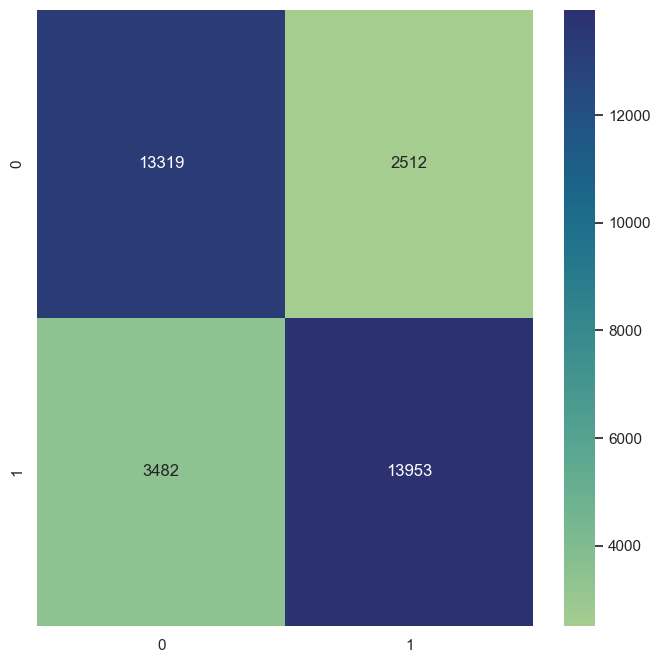

In [56]:
from sklearn.metrics import confusion_matrix 

cm = confusion_matrix(y_test, y_pred_rf)
fig = sns.heatmap(cm, annot=True, fmt=".0f",cmap="crest")
sns.set(rc={'figure.figsize':(4,4)})
# plt.savefig('confusion-matrix.png');
plt.show()


### 5.3.4 Lift Curve Evaluation <a name=5.3.4></a>

### Overview

In this context, one of our interests may reside on what benefits are derived from the usage of our model to target spenders and non-spenders, when launching a new campaign. Without the model, we would randomly target our clients, whereas with our model, we would target specifically those predicted to be top performers. The `Lift Curve` will show in numbers, by how much we can maximize targetting those spending customers, against doing it randomly (before the predictive model).


### Metric

The `Lift Curve`, as a performance metric for classification models, is defined as a cumulative ratio on the percentage of spenders reached at the total percentage of clients contacted.

* Formula:

<img width="200" style="float:center" 
src="https://i.imgur.com/Qufnxvc.png" />


So in our case, our `Current`would be the Current Ratio of `spend_60_flag = 1`, whereas the `Total` would be the spread of those spenders in the whole population.

In the `Lift Curve`, we order our population in descending order, attending to our target feature (`spend_60_flag`). Threfore, intuitively, the first shares of our population will correspond to the most likely customers to spend.

The following is a plot on how those different `Lift` values evolve along the cumulative percentage of the population. If our model brings value, we should see an initially higher than 2 `lift`, and slowly decading towards 1 as population increases.

<img width="300" style="float:center" 
src="https://i.imgur.com/mLNdlKr.png" />


And how should we interpret the curve?

The example `Lift Curve` shows how, by targetting the 20% of our population, we have reached aproximately a 60% of the total spenders in our population. So, in other words, using our model  brought us reaching three times more likely spenders than doing it randomly. This shows the potential of our model!

Cool!

Now, how can we implement the `Lift Curve` in our model?

Let's find it out!

As a result, we will follow these steps:

1. Obtain `predictions` from our `spend_60_flag`
2. Order the predictions in `descending order`
3. Compute the `real_ratio`of the `spend_60_flag`
4. Iterate through the `predictions`
5. Plot the results

Now that we reviewed the basics, let's jump to our model and evaluate the _Lift_ after running our predictions!

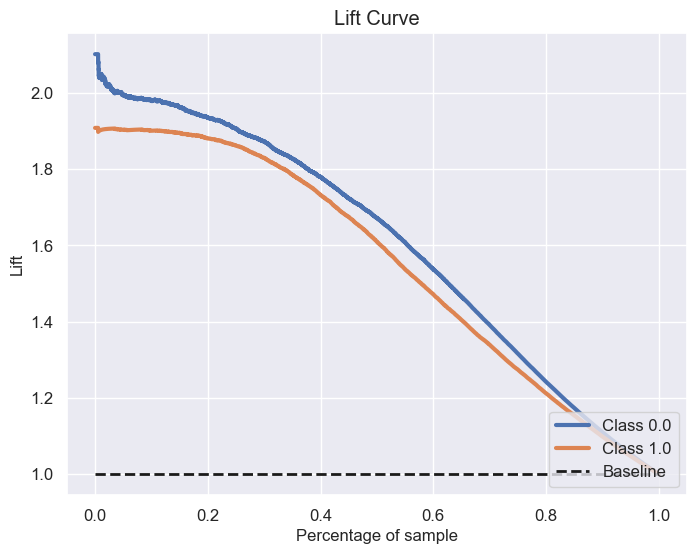

In [57]:
import scikitplot as skplt

skplt.metrics.plot_lift_curve(y_test, random_forest_random_search.predict_proba(X_test), figsize=(8, 6))
plt.show()

#### Conclusions from the lift curve

It seems our model is very good at identifying from a certain subset of our customers. It is twice as good than the baseline model when it comes 20% of the population. 1.8x good when it comes to 40% of the population and beyond that the efficacy of our model gradually drops. 

### 5.4 Predicting 2 months further into the future using the entire dataset <a name=5.4></a>

#### LRFM using the entire dataset

In [58]:
def lrfm(df):
    recency_features_full = df.query('sales_net>0')\
    [['client_id', 'date_order']].groupby('client_id')\
    .apply(lambda x: (x['date_order'].max() - max_date) / pd.to_timedelta(1,"day"))\
    .to_frame().set_axis(["recency"],axis=1)

    frequency_features_days_full = df.query('sales_net>0')\
    [['client_id','date_order']]\
    .groupby('client_id')['date_order']\
    .nunique()\
    .to_frame()\
    .set_axis(['frequency'], axis=1)
    
    monetary_features_full = df.groupby('client_id').aggregate({'sales_net':['sum','mean']})\
    .set_axis(['sales_sum','sales_mean'],axis=1)
    
    length_features_full= df.query('sales_net>0')\
    [['client_id', 'date_order']].groupby('client_id')\
    .apply(lambda x: (x['date_order'].max() - x['date_order'].min()) / pd.to_timedelta(1,"day"))\
    .to_frame().set_axis(["length"],axis=1)
    
    features_df_full= pd.concat([recency_features_full,frequency_features_days_full,monetary_features_full, length_features_full], axis=1)
    return features_df_full
    

In [59]:

final_df=lrfm(df) # note this is the entire dataset and using this now we will predict 60 days further into the future


In [60]:
final=final_df.fillna(0)

In [61]:
final

,recency,frequency,sales_sum,sales_mean,length
client_id,,,,,
6,-40.000,13.000,"5,882.233",147.056,655.000
7,-272.000,2.000,"1,190.777",79.385,161.000
14,-2.000,505.000,"3,103,187.000",243.158,725.000
18,-10.000,291.000,"219,488.172",98.691,716.000
25,-347.000,1.000,374.586,93.647,0.000
...,...,...,...,...,...
2274508,-704.000,1.000,0.000,0.000,0.000
2274517,-24.000,24.000,"17,157.936",209.243,696.000
188805,0.000,0.000,0.000,0.000,0.000


In [62]:
rf_clf=RandomForestClassifier(n_estimators= 2500, max_depth= 20, criterion= 'entropy') #just taken the best params
rf_clf.fit(X,y) #training on the entire dataset, earlier we held out 20%


RandomForestClassifier(criterion='entropy', max_depth=20, n_estimators=2500)

In [63]:
predictions_full=rf_clf.predict(final) # predicting on the entire dataset
probs_full=rf_clf.predict_proba(final) # probs of the predicted class

In [64]:
final['spend_60_flag']=predictions_full
max_probs = [max(sublist) for sublist in probs_full]
final['spend_60_flag']= final['spend_60_flag'].astype('int8')
final[['recency','length']]=final[['recency','length']].astype('int16')


In [65]:
pd.options.display.float_format = '{:,.2f}'.format
final['probability']=max_probs


### 5.5 Post Model evaluation <a name=5.5></a>

In [66]:
pd.options.display.float_format = "{:,.2f}".format
importances=rf_clf.feature_importances_ # checking for the most important features

# Convert importances into a dataframe
feature_importance_df = pd.DataFrame(importances, index=X.columns, columns=["Importance"])

# Sort the dataframe by importance
feature_importance_df.sort_values(by="Importance", ascending=False, inplace=True)
fig=px.bar(feature_importance_df.reset_index(), x='index', y='Importance',
          labels={'index': 'Features'})
fig.update_layout(height=300, width=600, title_text="Random Forest Feature Importance")
fig.show()

### 5.5.1 Lime <a name=5.5.1></a>

We can now look at local interpretability using LIME

In [67]:
explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X),
    feature_names=X.columns,
    class_names=['Not Spend', 'Spend'],
    mode='classification'
)

##### Let us first take a non spender and evaluate why has our model classified it as non spender

In [68]:
exp = explainer.explain_instance(
    data_row=X.iloc[4], 
    predict_fn=rf_clf.predict_proba
)

exp.show_in_notebook(show_table=True)

Our model is 94% confident of this customer not spending and recency, frequency, sales_sum and length, all of these values have contributed towards classifying this customer as a non spender whereas sales_mean is the value that has slightly contributed towards classifying this customer as spender

###### Lets look at a spender and do the same analysis

In [69]:
exp = explainer.explain_instance(
    data_row=X_test.iloc[1], 
    predict_fn=rf_clf.predict_proba
)

exp.show_in_notebook(show_table=True)

Our model is 99% confident of this customer spending. All the features have contributed towards this customer being a spender




### 5.5.2 Key takeaways from our RFM Analysis and Spend Propensity <a name=5.5.2></a>
- We computed LRFM for each customer and used those as feeatures to predict whether customers will purchase or not in the next 60 days
- Our Accuracy pretty decent on the hold out set
- We looked at various classification metrics including the ROC curve and the lift curve
- Recency is the most important feature with average sales being the least important
- We now have the LRFM features for each customer along with probabilities of not spending
- We have also implemented LIME and analysed local interpretability, we can analyse any customer and its accopanying classification reasons
- We will use these features now for customer segmentation

In [70]:
final # we now have the predictions and prob

,recency,frequency,sales_sum,sales_mean,length,spend_60_flag,probability
client_id,,,,,,,
6,-40,13.00,"5,882.23",147.06,655,1,0.62
7,-272,2.00,"1,190.78",79.39,161,0,0.85
14,-2,505.00,"3,103,187.00",243.16,725,1,1.00
18,-10,291.00,"219,488.17",98.69,716,1,1.00
25,-347,1.00,374.59,93.65,0,0,0.90
...,...,...,...,...,...,...,...
2274508,-704,1.00,0.00,0.00,0,0,1.00
2274517,-24,24.00,"17,157.94",209.24,696,1,0.76
188805,0,0.00,0.00,0.00,0,0,0.59


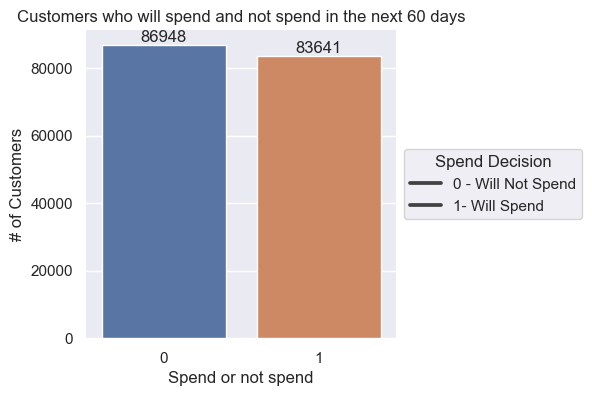

In [71]:
# Total number of spenders and non spenders
value_counts = final['spend_60_flag'].value_counts()

# Plot a bar plot using Seaborn
ax = sns.barplot(x=value_counts.index, y=value_counts.values)

# Add labels and title to the plot
plt.xlabel('Spend or not spend')
plt.ylabel('# of Customers')
plt.title('Customers who will spend and not spend in the next 60 days')

# Show the plot
for i in ax.containers:
    ax.bar_label(i)

# Add a legend
legend_labels = ['0 - Will Not Spend', '1- Will Spend']
plt.legend(title='Spend Decision', labels=legend_labels, loc='center left', bbox_to_anchor=(1.0, 0.5))

# Make the plot look visually appealing
sns.set_style("whitegrid")
sns.despine(left=True, bottom=True)

# Show the plot
plt.show()

## 6. Customer Segmentation <a name=6></a>

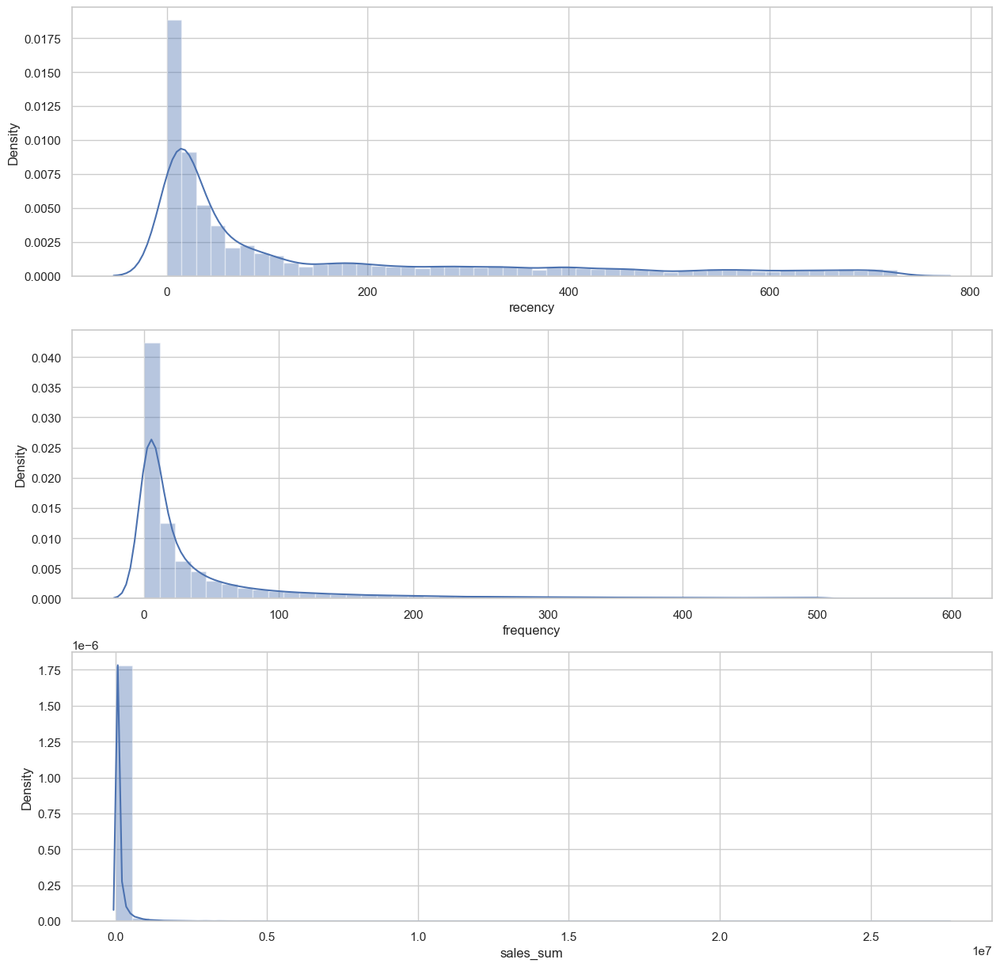

In [72]:
# Plot RFM distributions
plt.figure(figsize=(15,15))
# Plot distribution of R
plt.subplot(3, 1, 1); sns.distplot(np.abs(final['recency']))
# Plot distribution of F
plt.subplot(3, 1, 2); sns.distplot((final['frequency']))
# Plot distribution of M
plt.subplot(3, 1, 3); sns.distplot((final['sales_sum']))
# Show the plot
plt.show()

### 6.1 Creating 6 segments with percentile and score <a name=6.1></a>
- As you can see above our data is highly skewed, we will use log transformation to decrease this skewness to some extent
- We will then analyse these segments if its making business sense
- The segments will be made based on a total RFM score

In [73]:
# taking log since the data is highly skewed
r=np.log(np.abs(final['recency']))
f=np.log(final['frequency'])
m=np.log(final['sales_sum'])


final['r_percentile'] = r.rank(pct=True,ascending=False)
final['r_score'] = pd.qcut(final['r_percentile'], 5, labels=range(1,6,1))

final['f_percentile'] = f.rank(pct=True,ascending=True)
final['f_score'] = pd.qcut(final['f_percentile'], 5, labels=range(1,6,1))

final['m_percentile'] = m.rank(pct=True,ascending=True)
final['m_score'] = pd.qcut(final['m_percentile'], 5, labels=range(1,6,1))
final['rfm_score']=final[['r_score','f_score','m_score']].sum(axis=1) #using the sum for final score
final['rfm_score']=final['rfm_score'].astype('int8')



In [74]:
final=final.fillna(1) #there are customers whos sales_sum is negative

In [75]:
negative_customers=final[final.isna().any(axis=1)].reset_index()\
['client_id'].to_list()  # we will use this list to reduce their rfm_score to minimum

In [76]:
final['rfm_score']=np.where(final.reset_index()['client_id'].isin(negative_customers),3,final['rfm_score'])

In [77]:
final.rfm_score.value_counts()

15    18262
3     14141
8     13587
7     13466
6     13408
9     13370
5     13191
4     12781
10    12597
11    12502
12    11960
14    11002
13    10226
2        96
Name: rfm_score, dtype: int64

### 6.2 Deciding level and segments based on the sum of score <a name=6.2></a>

In [78]:
# Define rfm_level function
def rfm_level(df):
    if df['rfm_score'] == 15:
        return 'Creme de la creme'
    elif ((df['rfm_score'] >=13) and (df['rfm_score'] < 15)):
        return 'Champions'
    elif ((df['rfm_score'] >= 10) and (df['rfm_score'] < 13)):
        return 'Loyal'
    elif ((df['rfm_score'] >= 7) and (df['rfm_score'] < 10)):
        return 'Potential'
    elif ((df['rfm_score'] >= 5) and (df['rfm_score'] < 7)):
        return 'May lose'
    elif ((df['rfm_score'] >= 3) and (df['rfm_score'] < 5)):
        return 'Require Activation'
# Create a new variable RFM_Level
final['rfm_level'] = final.apply(rfm_level, axis=1)
final

,recency,frequency,sales_sum,sales_mean,length,spend_60_flag,probability,r_percentile,r_score,f_percentile,f_score,m_percentile,m_score,rfm_score,rfm_level
client_id,,,,,,,,,,,,,,,
6,-40,13.00,"5,882.23",147.06,655,1,0.62,0.53,3,0.51,3,0.49,3,9,Potential
7,-272,2.00,"1,190.78",79.39,161,0,0.85,0.23,2,0.16,1,0.24,2,5,May lose
14,-2,505.00,"3,103,187.00",243.16,725,1,1.00,0.97,5,1.00,5,1.00,5,15,Creme de la creme
18,-10,291.00,"219,488.17",98.69,716,1,1.00,0.82,5,0.97,5,0.95,5,15,Creme de la creme
25,-347,1.00,374.59,93.65,0,0,0.90,0.18,1,0.06,1,0.12,1,3,Require Activation
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2274508,-704,1.00,0.00,0.00,0,0,1.00,0.01,1,0.06,1,0.01,1,3,Require Activation
2274517,-24,24.00,"17,157.94",209.24,696,1,0.76,0.63,4,0.64,4,0.67,4,12,Loyal
188805,0,0.00,0.00,0.00,0,0,0.59,1.00,5,0.00,1,0.01,1,7,Potential


In [79]:
final.rfm_level.value_counts()

Potential             40423
Loyal                 37059
Require Activation    26922
May lose              26599
Champions             21228
Creme de la creme     18262
Name: rfm_level, dtype: int64

In [80]:
final['rfm_level'].fillna('Require Activation', inplace=True) # these are all again customers with negative transactions

In [81]:
final.head()

,recency,frequency,sales_sum,sales_mean,length,spend_60_flag,probability,r_percentile,r_score,f_percentile,f_score,m_percentile,m_score,rfm_score,rfm_level
client_id,,,,,,,,,,,,,,,
6,-40,13.00,"5,882.23",147.06,655,1,0.62,0.53,3,0.51,3,0.49,3,9,Potential
7,-272,2.00,"1,190.78",79.39,161,0,0.85,0.23,2,0.16,1,0.24,2,5,May lose
14,-2,505.00,"3,103,187.00",243.16,725,1,1.00,0.97,5,1.00,5,1.00,5,15,Creme de la creme
18,-10,291.00,"219,488.17",98.69,716,1,1.00,0.82,5,0.97,5,0.95,5,15,Creme de la creme
25,-347,1.00,374.59,93.65,0,0,0.90,0.18,1,0.06,1,0.12,1,3,Require Activation


In [82]:
# creating column for percentage of total for each level

customers_segment=final['rfm_level'].value_counts().to_frame()
total = customers_segment.rfm_level.sum()
customers_segment['percentage']=customers_segment['rfm_level'].apply(lambda x: x/total*100)
custom_order=['Creme de la creme','Champions','Loyal','Potential','May lose','Require Activation']
customers_segment=customers_segment.reindex(custom_order)
customers_segment

,rfm_level,percentage
Creme de la creme,18262,10.71
Champions,21228,12.44
Loyal,37059,21.72
Potential,40423,23.70
May lose,26599,15.59
Require Activation,27018,15.84


In [83]:
# Calculate average values for each RFM_Level
rfm_level_agg = final.groupby('rfm_level').agg({
    'recency': 'mean',
    'frequency': 'mean',
    'sales_sum': 'mean'
}).round(1)
rfm_level_agg

,recency,frequency,sales_sum
rfm_level,,,
Champions,-13.30,90.10,"83,709.80"
Creme de la creme,-4.70,233.10,"345,272.50"
Loyal,-49.60,32.70,"25,500.10"
May lose,-241.50,3.80,"1,935.80"
Potential,-127.60,10.60,"6,836.80"
Require Activation,-448.30,1.60,456.60


In [84]:
customers_segment=customers_segment.merge(rfm_level_agg,left_index=True,
      right_index=True,
      how='inner')
customers_segment

,rfm_level,percentage,recency,frequency,sales_sum
Creme de la creme,18262,10.71,-4.70,233.10,"345,272.50"
Champions,21228,12.44,-13.30,90.10,"83,709.80"
Loyal,37059,21.72,-49.60,32.70,"25,500.10"
Potential,40423,23.70,-127.60,10.60,"6,836.80"
May lose,26599,15.59,-241.50,3.80,"1,935.80"
Require Activation,27018,15.84,-448.30,1.60,456.60


In [85]:
customers_segment.rename(columns={'rfm_level':'Count_of_Customers'}, inplace=True)
customers_segment.rename(columns={'percentage':'%_of_total'}, inplace=True)
customers_segment.rename(columns={'recency':'mean_recency'}, inplace=True)
customers_segment.rename(columns={'frequency':'mean_frequency'}, inplace=True)
customers_segment.rename(columns={'sales_sum':'mean_monetary'},inplace=True)
customers_segment

,Count_of_Customers,%_of_total,mean_recency,mean_frequency,mean_monetary
Creme de la creme,18262,10.71,-4.70,233.10,"345,272.50"
Champions,21228,12.44,-13.30,90.10,"83,709.80"
Loyal,37059,21.72,-49.60,32.70,"25,500.10"
Potential,40423,23.70,-127.60,10.60,"6,836.80"
May lose,26599,15.59,-241.50,3.80,"1,935.80"
Require Activation,27018,15.84,-448.30,1.60,456.60


In [86]:
# Adding churn numbers to the above data frame against each level
customers_segment=customers_segment.merge(final.query('spend_60_flag==0').groupby('rfm_level')['spend_60_flag'].count().to_frame(),
                left_index=True,
      right_index=True,
      how='left').fillna(0)

In [87]:
customers_segment['spend_60_flag']=customers_segment['spend_60_flag'].astype('int16')

### 6.3 Final dataframe with customers segmented and values of each level <a name=6.3></a>

In [88]:
customers_segment.rename(columns={'spend_60_flag':'#Next 60 days non-spenders'}, inplace=True)
customers_segment



,Count_of_Customers,%_of_total,mean_recency,mean_frequency,mean_monetary,#Next 60 days non-spenders
Creme de la creme,18262,10.71,-4.70,233.10,"345,272.50",0
Champions,21228,12.44,-13.30,90.10,"83,709.80",123
Loyal,37059,21.72,-49.60,32.70,"25,500.10",4886
Potential,40423,23.70,-127.60,10.60,"6,836.80",28626
May lose,26599,15.59,-241.50,3.80,"1,935.80",26313
Require Activation,27018,15.84,-448.30,1.60,456.60,27000


## 7. Cohort Analysys by Customer Segments and answering some business questions based on the data we have now <a name=7></a>

In [89]:
df['rfm_level'] = df['client_id'].map(final['rfm_level'])

In [90]:
df['rfm_level']=df['rfm_level'].astype('category')

In [91]:
import plotly.express as px

# Plot a line plot with lines as categories
fig = px.line(df.groupby(['rfm_level','month_year'])['sales_net'].sum().to_frame().reset_index(), x="month_year", y="sales_net", color="rfm_level", title="Sales Numbers by Customer Segments",
              labels={"Month": "mont_year", "Sales": "sales_net", "Category": "rfm_level"})

# Update the layout to add the legend in the upper right
fig.update_layout(width=1000,height=600,
    legend=dict(x=1, y=1, traceorder="normal", font=dict(size=16)),
    xaxis_title="Month", yaxis_title="Sales", font=dict(size=16)
)

# Show the plot
fig.show()
# fig.write_html("cohort-analysis-rfm-segments.html")


### What do we observe here? <a name=7.1></a>
- The same seasonality is observed acorss all segments, The seasonality is more pronounced with the best customers

### 7.2 Business Questions <a name=7.2></a>

#### Who are the customers who have purchased recently but are expected not to spend in the next 60 days with a high probability

In [92]:
final['rfm_level']=final['rfm_level'].astype('category')


In [93]:
final.query('recency > -30 & spend_60_flag==0 & probability >0.7').sort_values('sales_sum', ascending=False)[['recency','frequency','sales_sum','length','probability']]

,recency,frequency,sales_sum,length,probability
client_id,,,,,
1309926,-20,6.00,"103,599.23",229,0.75
1912725,-24,2.00,"68,276.65",2,0.75
1778490,-18,2.00,"41,884.08",1,0.75
2144208,-20,4.00,"39,962.96",63,0.73
1950572,-24,1.00,"33,582.59",0,0.77
...,...,...,...,...,...
1567603,-24,1.00,0.00,0,0.91
777157,-27,1.00,0.00,0,0.88
1967963,-24,1.00,0.00,0,0.91


#### How many customers have purchased frequently but are predicted not to spend in the next 60 days with a high probability

In [94]:
final.query('f_score ==  5 & spend_60_flag==0 & probability >0.7').sort_values('sales_sum', ascending=False)

,recency,frequency,sales_sum,sales_mean,length,spend_60_flag,probability,r_percentile,r_score,f_percentile,f_score,m_percentile,m_score,rfm_score,rfm_level
client_id,,,,,,,,,,,,,,,
140313,-157,374.00,"1,791,530.25",225.89,570,0,0.92,0.32,2,0.98,5,1.00,5,12,Loyal
49886,-235,155.00,"1,603,427.38","1,004.02",492,0,0.87,0.25,2,0.91,5,1.00,5,12,Loyal
811505,-251,331.00,"1,419,586.62",86.69,476,0,0.94,0.24,2,0.97,5,1.00,5,12,Loyal
174547,-185,340.00,"1,412,339.25",213.47,542,0,0.91,0.29,2,0.98,5,1.00,5,12,Loyal
1225282,-122,205.00,"1,403,671.50",419.38,486,0,0.90,0.35,2,0.94,5,1.00,5,12,Loyal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1297980,-271,73.00,"9,817.64",40.40,455,0,0.94,0.23,2,0.82,5,0.58,3,10,Loyal
374745,-198,70.00,"8,555.64",28.33,515,0,0.85,0.28,2,0.82,5,0.56,3,10,Loyal
1640814,-327,79.00,"7,965.73",36.71,400,0,0.94,0.19,1,0.83,5,0.54,3,9,Potential


#### How many customers have purchased a lot in the past (high m-score) but are predicted not to spend in the next 60 days with a high probability



In [95]:
final.query('m_score ==  5 & spend_60_flag==0 & probability >0.7').sort_values('sales_sum', ascending=False)

,recency,frequency,sales_sum,sales_mean,length,spend_60_flag,probability,r_percentile,r_score,f_percentile,f_score,m_percentile,m_score,rfm_score,rfm_level
client_id,,,,,,,,,,,,,,,
140313,-157,374.00,"1,791,530.25",225.89,570,0,0.92,0.32,2,0.98,5,1.00,5,12,Loyal
445592,-362,12.00,"1,711,312.12","6,900.45",288,0,0.86,0.17,1,0.50,3,1.00,5,9,Potential
1109597,-102,2.00,"1,620,376.88","47,658.14",91,0,0.76,0.38,2,0.16,1,1.00,5,8,Potential
49886,-235,155.00,"1,603,427.38","1,004.02",492,0,0.87,0.25,2,0.91,5,1.00,5,12,Loyal
811505,-251,331.00,"1,419,586.62",86.69,476,0,0.94,0.24,2,0.97,5,1.00,5,12,Loyal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
788272,-473,54.00,"43,175.89",127.74,251,0,0.93,0.10,1,0.78,4,0.80,5,10,Loyal
1816866,-494,63.00,"43,141.69",75.29,222,0,0.91,0.10,1,0.80,5,0.80,5,11,Loyal
1195852,-355,15.00,"43,088.40",458.39,361,0,0.82,0.17,1,0.54,3,0.80,5,9,Potential


### 7.3 Refund Analysis by customer <a name=7.3></a>

In [96]:
refunds=(df.query('sales_net < 0')
.groupby('client_id')["sales_net"]
.sum()
.to_frame()
.sort_values('sales_net', ascending=True)
.join(final['rfm_level'], how='left')
.join(df.query('sales_net > 0')
.groupby('client_id')['sales_net'].sum().to_frame(), how='left', rsuffix='_right')
.groupby('rfm_level')['sales_net','sales_net_right'].sum()
.sort_values('sales_net_right', ascending=False)
.rename(columns={'sales_net':'Refunds','sales_net_right':"Total_Sales"})
.assign(Net_Sales=lambda x: x['Total_Sales'] + x['Refunds'])
.assign(Percent_Refunds=lambda x: np.abs(x['Refunds'])/x['Total_Sales']*100))

refunds

,Refunds,Total_Sales,Net_Sales,Percent_Refunds
rfm_level,,,,
Creme de la creme,"-363,069,600.00","6,648,773,632.00","6,285,704,192.00",5.46
Champions,"-107,592,760.00","1,807,510,656.00","1,699,917,952.00",5.95
Loyal,"-70,451,888.00","857,303,360.00","786,851,456.00",8.22
Potential,"-24,641,212.00","175,894,032.00","151,252,816.00",14.01
May lose,"-7,111,528.00","21,086,210.00","13,974,682.00",33.73
Require Activation,"-4,427,250.00","5,801,708.50","1,374,458.50",76.31


### 7.4 Channel behaviour by Customer Segments <a name=7.4></a>

In [97]:
pd.options.display.float_format = '{:,.3f}'.format
channel_sales=df.groupby(['rfm_level','order_channel'])['sales_net'].sum().to_frame().reset_index()

channel_sales.groupby(['rfm_level'])['sales_net'].sum().to_frame()

channel_sales=channel_sales.set_index('rfm_level').merge(channel_sales.groupby(['rfm_level'])['sales_net'].sum().to_frame(), how ='left', right_index=True, left_index=True)

channel_sales['percentage_of_sales']=channel_sales['sales_net_x']/channel_sales['sales_net_y']*100
fig = px.bar(channel_sales.reset_index(), x="rfm_level", y="percentage_of_sales", color="order_channel", title="Sales by Segment and Channel Distribution")
fig.update_xaxes(categoryorder='array', categoryarray= ['Creme de la creme','Champions','Loyal','Potential','May lose','Require Activation'])
fig.show()

### What do we observe here?
- Our best customers tend to buy more via online
- The best customers also seem to be more self serve with less at the store and orders placed mostly by phone

### 7.5 Scatter plot of all our customers based on RFM  <a name=7.5></a>

In [98]:
# For the sake of this plot, we are getting rid of all the negative values so in this case for recency, the lower the better
final_plot=final[['recency','frequency','sales_sum','rfm_level','rfm_score']].copy()
final_plot['recency']=np.abs(final_plot['recency'])
final_plot[['sales_sum']] = final_plot[['sales_sum']].applymap(lambda x: max(0, x))

fig = px.scatter(final_plot.reset_index(), 
                 x="recency", 
                 y="frequency", 
                 color="rfm_level",
                 size='sales_sum', 
                 hover_data=['rfm_score'],
                 template='plotly_dark',
                 color_discrete_sequence=px.colors.qualitative.Plotly)
fig.show()

## 8. Graph Analysis between branches and Customers <a name=8></a>

In [99]:
df_branches=df.groupby(['branch_id','client_id'])['sales_net'].sum().to_frame().reset_index()

In [100]:
import networkx as nx
from networkx.algorithms import bipartite


In [101]:
# Create an empty graph
G = nx.Graph()

# Add nodes for the branches and customers to the graph
branch_nodes = [row['branch_id'] for index, row in df_branches.iterrows()]
customer_nodes = [row['client_id'] for index, row in df_branches.iterrows()]
G.add_nodes_from(branch_nodes, bipartite=0)
G.add_nodes_from(customer_nodes, bipartite=1)

# Add edges to the graph, we can also create edges with transactions as weights but for this we do not need that
for index, row in df_branches.iterrows():
    branch_id = row['branch_id']
    client_id = row['client_id']
#     transactions = row['sales_net']
    G.add_edge(branch_id, client_id)

# Calculate the degree centrality of each branch
degree_centrality= nx.degree_centrality(G)
dc=degree_centrality


In [102]:
max_dc = max(dc.values())
for node, value in dc.items():
    dc[node] = value / max_dc

# Create a new column in the dataframe for normalized branch degree centrality
df_branches['normalized_branch_degree_centrality'] = 0

# Fill the normalized branch degree centrality column in the dataframe
for index, row in df_branches.iterrows():
    if row['branch_id'] in branch_nodes:
        branch_id = row['branch_id']
        centrality = dc[branch_id]
        df_branches.loc[df_branches['branch_id'] == branch_id, 'normalized_branch_degree_centrality'] = centrality


In [103]:
x=df_branches.groupby(['branch_id','normalized_branch_degree_centrality'])['sales_net'].sum().to_frame()
fig = px.scatter(x.reset_index(), x="sales_net", y="normalized_branch_degree_centrality",hover_data=['branch_id'],
                labels={'normalized_branch_degree_centrality':'Degree of Connected Customers', 'sales_net': 'Revenue'},
                title="Revenue Generated vs numbers of Customers Serviced")
fig.write_html('degree.html')
fig.show()

#### Removing some of the outliers with really high revenue

In [104]:
x=df_branches.groupby(['branch_id','normalized_branch_degree_centrality'])['sales_net'].sum().to_frame().query('sales_net < 50000000')
fig = px.scatter(x.reset_index(), x="sales_net", y="normalized_branch_degree_centrality",hover_data=['branch_id'],
                labels={'normalized_branch_degree_centrality':'Degree of Connected Customers', 'sales_net': 'Revenue'},
                title="Revenue Generated vs numbers of Customers Serviced by Branches")
# fig.write_html('degree.html')
fig.show()

### What do we observe here?
- The idea here is to pay attention to branches that are connected with many customers but are not able to generate as much revenue
- These branches need to be focused upon as they seem to be influential

## 9. Scatter plot of revenue and count of unique products purchased by customer <a name=9></a>

In [105]:
# we will take the top 10000 customers for this
top10000=(df.groupby('client_id')['sales_net'].sum().to_frame().sort_values('sales_net', ascending=False).head(10000)
 .reset_index()['client_id'].to_list())



m=(df.query('client_id in@top10000').groupby('client_id')['product_id'].nunique().to_frame()
 .reset_index()
 .merge(df.groupby('client_id')['sales_net'].sum(),on='client_id', how='inner'))
m

,client_id,product_id,sales_net
0,14,4898,"3,103,187.000"
1,18,786,"219,488.172"
2,259,371,"200,736.516"
3,753,1674,"997,376.062"
4,991,513,"413,075.250"
...,...,...,...
9995,2273787,318,"236,140.312"
9996,2273941,642,"364,601.375"
9997,2274084,916,"441,841.719"
9998,2274190,1734,"338,787.844"


In [106]:
mean = m["sales_net"].mean()
sd = df["sales_net"].std()
n = m[(m["sales_net"] <= mean+(3*sd))]
fig = px.scatter(n, x="sales_net", y="product_id",hover_data=['client_id'],
                labels={
                     "product_id": "Count of Unique Products",
                     "sales_net": "Revenue"},
                title="Products purchased vs Revenue Generated")
# fig.write_html('degree.html')
fig.show()



### what do we observe here?
- There are multiple ways to look at this
- Customers who buy a lot of different products but do so in smaller quantities and hence they dont score high on revenue
- Customers who are generating lot of revenue but are not buying many different products

## 10. Closing<a name=10></a>

- In this notebook, we carried out extensive EDA and understood the business, the seasonality and nuances at a customer level, channel level and branch level

- We then conducted customer segmentation and we repeatedly saw in our analysis the different behaviour and preferences of our customer niches

- A model was trained to predict whether customers will spend or not in the next 60 days

- We also leveraged on basic graph analysis to understand how various branches are interacting with customers

- All these analysis have been detailed out in our accompaying report and based on these insights, we have come up with various recommednations for sales & marketing teams
